# 目的
考案したニューロンスコアの間違い種類ごとの分布を確認する

In [1]:
%load_ext autoreload
%autoreload 2

## import 部

In [2]:
import os, sys, time, pickle, json, math
from tqdm import tqdm
from collections import defaultdict
from itertools import product
import numpy as np
import pandas as pd
import torch
from utils.helper import get_device, json2dict
from utils.vit_util import identfy_tgt_misclf, localize_neurons_with_mean_activation, get_batched_hs, get_batched_labels, ViTFromLastLayer
from utils.constant import ViTExperiment, ExperimentRepair1, Experiment3, ExperimentRepair2
from utils.log import set_exp_logging
from logging import getLogger
from datasets import load_from_disk
from transformers import ViTForImageClassification
import torch
import torch.optim as optim
import matplotlib.pyplot as plt
import seaborn as sns
# Notebook向け
%matplotlib inline
from itertools import product
from sklearn.preprocessing import MinMaxScaler

logger = getLogger("base_logger")
device = get_device()

2025-04-14 21:29:21.024051: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-04-14 21:29:21.216421: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-14 21:29:21.905777: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2025-04-14 21:29:21.905843: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not l

Device: cuda


## Neuron Scoreを集計するメイン部分

In [3]:
def main(ds_name, k, tgt_rank, misclf_type, fpfn, n_ratio, w_num):
    print(f"ds_name: {ds_name}, fold_id: {k}, tgt_rank: {tgt_rank}, misclf_type: {misclf_type}, fpfn: {fpfn}, n_ratio: {n_ratio}, w_num: {w_num}")
    
    ts = time.perf_counter()
    
    # datasetをロード (true_labelsが欲しいので)
    ds_dirname = f"{ds_name}_fold{k}"
    ds = load_from_disk(os.path.join(ViTExperiment.DATASET_DIR, ds_dirname))
    label_col = "fine_label"
    # ラベルの取得 (shuffleされない)
    labels = {
        "train": np.array(ds["train"][label_col]),
        "repair": np.array(ds["repair"][label_col]),
        "test": np.array(ds["test"][label_col])
    }
    tgt_pos = ViTExperiment.CLS_IDX
    
    # 結果とかログの保存先を先に作っておく
    # pretrained modelのディレクトリ
    pretrained_dir = getattr(ViTExperiment, ds_name).OUTPUT_DIR.format(k=k)
    save_dir = os.path.join(pretrained_dir, f"misclf_top{tgt_rank}", f"{misclf_type}_weights_location")
    if misclf_type == "all":
        save_dir = os.path.join(pretrained_dir, f"all_weights_location")
    if fpfn is not None and misclf_type == "tgt":
        save_dir = os.path.join(pretrained_dir, f"misclf_top{tgt_rank}", f"{misclf_type}_{fpfn}_weights_location")
    os.makedirs(save_dir, exist_ok=True)
        
    # このpythonのファイル名を取得
    # this_file_name = os.path.basename(__file__).split(".")[0]
    exp_name = f"exp-fl-6-1_n{n_ratio}"
    # loggerの設定をして設定情報を表示
    logger = set_exp_logging(exp_dir=save_dir, exp_name=exp_name)
    logger.info(f"ds_name: {ds_name}, fold_id: {k}, tgt_rank: {tgt_rank}, n_ratio: {n_ratio}, w_num: {w_num}, misclf_type: {misclf_type}")

    # tgt_rankの誤分類情報を取り出す
    tgt_split = "repair" # NOTE: we only use repair split for repairing
    tgt_layer = 11 # NOTE: we only use the last layer for repairing
    logger.info(f"tgt_layer: {tgt_layer}, tgt_split: {tgt_split}")
    misclf_info_dir = os.path.join(pretrained_dir, "misclf_info")
    misclf_pair, tgt_label, tgt_mis_indices = identfy_tgt_misclf(misclf_info_dir, tgt_split=tgt_split, tgt_rank=tgt_rank, misclf_type=misclf_type, fpfn=fpfn)
    logger.info(f"misclf_pair: {misclf_pair}, tgt_label: {tgt_label}, len(tgt_mis_indices): {len(tgt_mis_indices)}")
    
    # 中間ニューロン値のキャッシュのロード
    mid_cache_dir = os.path.join(pretrained_dir, f"cache_states_{tgt_split}")
    mid_save_path = os.path.join(mid_cache_dir, f"intermediate_states_l{tgt_layer}.pt")
    cached_mid_states = torch.load(mid_save_path, map_location="cpu") # (tgt_splitのサンプル数(10000), 中間ニューロン数(3072))
    # cached_mid_statesをnumpy配列にする
    cached_mid_states = cached_mid_states.detach().numpy().copy()
    print(f"cached_mid_states.shape: {cached_mid_states.shape}")

    # ===============================================
    # localization phase
    # ===============================================

    if misclf_type == "src_tgt" or misclf_type == "tgt":
        vscore_before_dir = os.path.join(pretrained_dir, f"misclf_top{tgt_rank}", "vscores_before")
        vscore_dir = os.path.join(pretrained_dir, f"misclf_top{tgt_rank}", "vscores")
        vscore_after_dir = os.path.join(pretrained_dir, f"misclf_top{tgt_rank}", "vscores_after")
    elif misclf_type == "all":
        vscore_before_dir = os.path.join(pretrained_dir, "vscores_before")
        vscore_dir = os.path.join(pretrained_dir, "vscores")
        vscore_after_dir = os.path.join(pretrained_dir, "vscores_after")
    logger.info(f"vscore_before_dir: {vscore_before_dir}")
    logger.info(f"vscore_dir: {vscore_dir}")
    logger.info(f"vscore_after_dir: {vscore_after_dir}")
    # vscoreとmean_activationを用いたlocalizationを実行
    method_name = "vscore_mean_activation"
    location_save_path = os.path.join(save_dir, f"exp-fl-3_location_n{n_ratio}_w{w_num}_neuron.npy")
    places_to_neuron, tgt_neuron_score, neuron_score = localize_neurons_with_mean_activation(vscore_before_dir, vscore_dir, vscore_after_dir, tgt_layer, n_ratio, intermediate_states=cached_mid_states, tgt_mis_indices=tgt_mis_indices, misclf_pair=misclf_pair, tgt_label=tgt_label, fpfn=fpfn, return_all_neuron_score=True)
    return neuron_score

## 間違い種類ごとに Neuron Score 集計をループ

results に間違い種類をキーとした neuron score の list が格納される

In [4]:
ds = "c100"
# k_list = range(5)
k_list = [0]
tgt_rank_list = range(1, 4)
# misclf_type_list = ["all", "src_tgt", "tgt"]
misclf_type_list = ["src_tgt", "tgt"]
fpfn_list = [None, "fp", "fn"]
results = defaultdict(list)
exp_list = [Experiment3, ExperimentRepair1, ExperimentRepair2]

for exp in exp_list:
    n_ratio, w_num = exp.NUM_IDENTIFIED_NEURONS_RATIO, exp.NUM_IDENTIFIED_WEIGHTS
    w_num = 8 * w_num * w_num
    for k, tgt_rank, misclf_type, fpfn in product(k_list, tgt_rank_list, misclf_type_list, fpfn_list):
        print(f"Start: ds={ds}, k={k}, tgt_rank={tgt_rank}, misclf_type={misclf_type}, fpfn={fpfn}")
        if (misclf_type == "src_tgt" or misclf_type == "all") and fpfn is not None: # misclf_type == "src_tgt" or "all"の時はfpfnはNoneだけでいい
            continue
        if misclf_type == "all" and tgt_rank != 1: # misclf_type == "all"の時にtgt_rankは関係ないのでこのループもスキップすべき
            continue
        ret = main(ds, k, tgt_rank, misclf_type, fpfn, n_ratio, w_num)
        results[(tgt_rank, misclf_type, fpfn, n_ratio, w_num)] = ret
        print(results)

Start: ds=c100, k=0, tgt_rank=1, misclf_type=src_tgt, fpfn=None
ds_name: c100, fold_id: 0, tgt_rank: 1, misclf_type: src_tgt, fpfn: None, n_ratio: 0.03, w_num: 73728
cached_mid_states.shape: (10000, 3072)
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([2.41716484e-03, 9.75377333e-04, 1.04933650e-03, ...,
       3.87358786e-06, 4.82223403e-04, 2.62420385e-02])})
Start: ds=c100, k=0, tgt_rank=1, misclf_type=src_tgt, fpfn=fp
Start: ds=c100, k=0, tgt_rank=1, misclf_type=src_tgt, fpfn=fn
Start: ds=c100, k=0, tgt_rank=1, misclf_type=tgt, fpfn=None
ds_name: c100, fold_id: 0, tgt_rank: 1, misclf_type: tgt, fpfn: None, n_ratio: 0.03, w_num: 73728
cached_mid_states.shape: (10000, 3072)
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([2.41716484e-03, 9.75377333e-04, 1.04933650e-03, ...,
       3.87358786e-06, 4.82223403e-04, 2.62420385e-02]), (1, 'tgt', None, 0.03, 73728): array([2.19499529e-03, 2.64187441e-04, 1.05441241e-03, ...,
       3.68768358e-0

## ニューロンスコアの分布を可視化

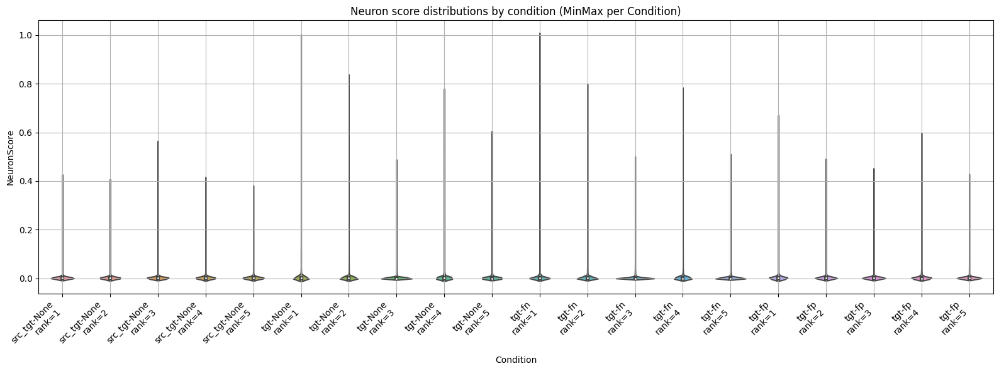

In [53]:
plot_data = []

ds = "c100"
k_list = [0]
tgt_rank_list = range(1, 4)
misclf_type_list = ["src_tgt", "tgt"]
fpfn_list = [None, "fp", "fn"]
exp_list = [Experiment3, ExperimentRepair1, ExperimentRepair2]

for exp in exp_list:
    n_ratio, w_num = exp.NUM_IDENTIFIED_NEURONS_RATIO, exp.NUM_IDENTIFIED_WEIGHTS
    w_num = 8 * w_num * w_num
    exp_name = exp.__name__  # クラス名をラベルに使う
    
    for k, tgt_rank, misclf_type, fpfn in product(k_list, tgt_rank_list, misclf_type_list, fpfn_list):
        if (misclf_type in {"src_tgt", "all"}) and fpfn is not None:
            continue
        if misclf_type == "all" and tgt_rank != 1:
            continue

        key = (tgt_rank, misclf_type, fpfn, n_ratio, w_num)
        if key not in results:
            continue

        scores = results[key]
        label = f"{misclf_type}-{fpfn}\nrank={tgt_rank}"
        for s in scores:
            plot_data.append({
                "NeuronScore": s,
                "Condition": label
            })

# DataFrame に変換
df = pd.DataFrame(plot_data)

# Condition(ラベル)ごとにMinMaxScalerで[0,1]に正規化
df_list = []
for cond, subdf in df.groupby("Condition"):
    scaler = MinMaxScaler(feature_range=(0, 1))
    arr = subdf["NeuronScore"].values.reshape(-1, 1)
    scaled = scaler.fit_transform(arr)
    subdf["NeuronScoreMinMax"] = scaled.flatten()
    df_list.append(subdf)

df_minmax = pd.concat(df_list, ignore_index=True)

# プロット
plt.figure(figsize=(16, 6))
sns.violinplot(x="Condition", y="NeuronScore", data=df_minmax, showfliers=False)
plt.xticks(rotation=45, ha="right")
plt.title("Neuron score distributions by condition (MinMax per Condition)")
plt.grid(True)
plt.tight_layout()
plt.show()

In [6]:
# 任意のパーセンタイルを指定（ここでは25%, 50%, 75%）
percentiles = [0, 0.25, 0.5, 0.75, 0.9, 0.99, 0.995, 0.999, 1]

# groupby + quantile で条件ごとにパーセンタイルを計算
summary = df_minmax.groupby("Condition")["NeuronScoreMinMax"].quantile(percentiles).unstack()

# カラム名をわかりやすく
summary.columns = [f"{p*100}%" for p in percentiles]

# ソート（必要に応じて）
summary = summary.sort_index()
summary

,0%,25.0%,50.0%,75.0%,90.0%,99.0%,99.5%,99.9%,100%
Condition,,,,,,,,,
src_tgt-None\nrank=1,0.0,0.000013,0.001285,0.005439,0.015530,0.353069,0.437278,0.582925,1.0
src_tgt-None\nrank=2,0.0,0.000013,0.001299,0.005439,0.018655,0.410355,0.537170,0.763211,1.0
src_tgt-None\nrank=3,0.0,0.000010,0.001040,0.004466,0.014985,0.254012,0.301635,0.476428,1.0
src_tgt-None\nrank=4,0.0,0.000013,0.001411,0.006072,0.022333,0.395598,0.547789,0.788197,1.0
src_tgt-None\nrank=5,0.0,0.000013,0.001381,0.005962,0.021491,0.465679,0.551909,0.776031,1.0
tgt-None\nrank=1,0.0,0.000005,0.000528,0.002321,0.008250,0.175372,0.245276,0.442925,1.0
tgt-None\nrank=2,0.0,0.000004,0.000480,0.002218,0.010512,0.161052,0.223509,0.561954,1.0
tgt-None\nrank=3,0.0,0.000005,0.000619,0.002657,0.011510,0.162572,0.213027,0.412592,1.0
tgt-None\nrank=4,0.0,0.000004,0.000442,0.002050,0.011127,0.141378,0.246601,0.705743,1.0


# Arachneで計算する重みごとのスコアの分布も見たい

In [7]:
from utils.arachne import calculate_bi_fi, calculate_top_n_flattened
from utils.vit_util import get_ori_model_predictions

def main(ds_name, k, tgt_rank, misclf_type, fpfn, n_ratio, w_num):
    print(f"ds_name: {ds_name}, fold_id: {k}, tgt_rank: {tgt_rank}, misclf_type: {misclf_type}, fpfn: {fpfn}, n_ratio: {n_ratio}, w_num: {w_num}")
    
    ts = time.perf_counter()
    
    # datasetをロード (true_labelsが欲しいので)
    ds_dirname = f"{ds_name}_fold{k}"
    ds = load_from_disk(os.path.join(ViTExperiment.DATASET_DIR, ds_dirname))
    label_col = "fine_label"
    # ラベルの取得 (shuffleされない)
    labels = {
        "train": np.array(ds["train"][label_col]),
        "repair": np.array(ds["repair"][label_col]),
        "test": np.array(ds["test"][label_col])
    }
    tgt_pos = ViTExperiment.CLS_IDX
    
    # 結果とかログの保存先を先に作っておく
    # pretrained modelのディレクトリ
    pretrained_dir = getattr(ViTExperiment, ds_name).OUTPUT_DIR.format(k=k)
    save_dir = os.path.join(pretrained_dir, f"misclf_top{tgt_rank}", f"{misclf_type}_weights_location")
    if misclf_type == "all":
        save_dir = os.path.join(pretrained_dir, f"all_weights_location")
    if fpfn is not None and misclf_type == "tgt":
        save_dir = os.path.join(pretrained_dir, f"misclf_top{tgt_rank}", f"{misclf_type}_{fpfn}_weights_location")
    os.makedirs(save_dir, exist_ok=True)
        
    # このpythonのファイル名を取得
    # this_file_name = os.path.basename(__file__).split(".")[0]
    exp_name = f"exp-fl-6_n{n_ratio}"
    # loggerの設定をして設定情報を表示
    logger = set_exp_logging(exp_dir=save_dir, exp_name=exp_name)
    logger.info(f"ds_name: {ds_name}, fold_id: {k}, tgt_rank: {tgt_rank}, n_ratio: {n_ratio}, w_num: {w_num}, misclf_type: {misclf_type}")

    # tgt_rankの誤分類情報を取り出す
    tgt_split = "repair" # NOTE: we only use repair split for repairing
    tgt_layer = 11 # NOTE: we only use the last layer for repairing
    logger.info(f"tgt_layer: {tgt_layer}, tgt_split: {tgt_split}")
    misclf_info_dir = os.path.join(pretrained_dir, "misclf_info")
    misclf_pair, tgt_label, tgt_mis_indices = identfy_tgt_misclf(misclf_info_dir, tgt_split=tgt_split, tgt_rank=tgt_rank, misclf_type=misclf_type, fpfn=fpfn)
    logger.info(f"misclf_pair: {misclf_pair}, tgt_label: {tgt_label}, len(tgt_mis_indices): {len(tgt_mis_indices)}")
    
    # original model の repair setの各サンプルに対する正解/不正解のインデックスを取得
    pred_res_dir = os.path.join(pretrained_dir, "pred_results", "PredictionOutput")
    if misclf_type == "tgt":
        ori_pred_labels, is_correct, indices_to_correct, is_correct_others, indices_to_correct_others = get_ori_model_predictions(pred_res_dir, labels, tgt_split=tgt_split, misclf_type=misclf_type, tgt_label=tgt_label)
    else:
        ori_pred_labels, is_correct, indices_to_correct = get_ori_model_predictions(pred_res_dir, labels, tgt_split=tgt_split, misclf_type=misclf_type, tgt_label=tgt_label)
    print(f"len(indices_to_correct): {len(indices_to_correct)}, len(tgt_mis_indices): {len(tgt_mis_indices)}")
    
    # 中間ニューロン値のキャッシュのロード
    mid_cache_dir = os.path.join(pretrained_dir, f"cache_states_{tgt_split}")
    mid_save_path = os.path.join(mid_cache_dir, f"intermediate_states_l{tgt_layer}.pt")
    cached_mid_states = torch.load(mid_save_path, map_location="cpu") # (tgt_splitのサンプル数(10000), 中間ニューロン数(3072))
    # cached_mid_statesをnumpy配列にする
    cached_mid_states = cached_mid_states.detach().numpy().copy()
    print(f"cached_mid_states.shape: {cached_mid_states.shape}")

    # ===============================================
    # localization phase
    # ===============================================

    if misclf_type == "src_tgt" or misclf_type == "tgt":
        vscore_before_dir = os.path.join(pretrained_dir, f"misclf_top{tgt_rank}", "vscores_before")
        vscore_dir = os.path.join(pretrained_dir, f"misclf_top{tgt_rank}", "vscores")
        vscore_after_dir = os.path.join(pretrained_dir, f"misclf_top{tgt_rank}", "vscores_after")
    elif misclf_type == "all":
        vscore_before_dir = os.path.join(pretrained_dir, "vscores_before")
        vscore_dir = os.path.join(pretrained_dir, "vscores")
        vscore_after_dir = os.path.join(pretrained_dir, "vscores_after")
    logger.info(f"vscore_before_dir: {vscore_before_dir}")
    logger.info(f"vscore_dir: {vscore_dir}")
    logger.info(f"vscore_after_dir: {vscore_after_dir}")
    # vscoreとmean_activationを用いたlocalizationを実行
    method_name = "vscore_mean_activation"
    location_save_path = os.path.join(save_dir, f"exp-fl-3_location_n{n_ratio}_w{w_num}_neuron.npy")
    places_to_neuron, tgt_neuron_score, neuron_scores = localize_neurons_with_mean_activation(vscore_before_dir, vscore_dir, vscore_after_dir, tgt_layer, n_ratio, intermediate_states=cached_mid_states, tgt_mis_indices=tgt_mis_indices, misclf_pair=misclf_pair, tgt_label=tgt_label, fpfn=fpfn, return_all_neuron_score=True)
    # log表示
    logger.info(f"places_to_neuron={places_to_neuron}")
    logger.info(f"num(pos_to_fix)={len(places_to_neuron)}")
    # 位置情報を保存
    np.save(location_save_path, places_to_neuron)
    logger.info(f"saved location information to {location_save_path}")
    # print(f"saved location information to {location_save_path}")
    # print(f"len(places_to_neuron): {len(places_to_neuron)}")
    # print(f"tgt_neuron_score.shape: {tgt_neuron_score.shape}")
    # print(f"tgt_neuron_score: {tgt_neuron_score}")
    # print(f"neuron_scores.shape: {neuron_scores.shape}")
    # print(f"neuron_scores: {neuron_scores}")
    
    # ============================================================
    # ここまでで Vdiff x Use_i によるニューロン特定ができたので，次は勾配も使った重み特定をする．
    # ============================================================
    
    # キャッシュの保存用のディレクトリ
    cache_dir = os.path.join(pretrained_dir, f"cache_hidden_states_before_layernorm_{tgt_split}")
    cache_path = os.path.join(cache_dir, f"hidden_states_before_layernorm_{tgt_layer}.npy")
    # cache_pathに存在することを確認
    assert os.path.exists(cache_path), f"cache_path: {cache_path} does not exist."
    # vit_utilsの関数を使ってバッチを取得
    batch_size = ViTExperiment.BATCH_SIZE
    
    # 正解サンプル (I_pos) と誤りサンプル (I_neg) を分割
    correct_batched_hidden_states = get_batched_hs(cache_path, batch_size, indices_to_correct)
    correct_batched_labels = get_batched_labels(labels[tgt_split], batch_size, indices_to_correct)
    incorrect_batched_hidden_states = get_batched_hs(cache_path, batch_size, tgt_mis_indices)
    incorrect_batched_labels = get_batched_labels(labels[tgt_split], batch_size, tgt_mis_indices)
    
    # hidden_states_before_layernormのshapeを確認
    assert len(correct_batched_hidden_states) == len(correct_batched_labels), f"len(correct_batched_hidden_states): {len(correct_batched_hidden_states)}, len(correct_batched_labels): {len(correct_batched_labels)}"
    assert len(incorrect_batched_hidden_states) == len(incorrect_batched_labels), f"len(incorrect_batched_hidden_states): {len(incorrect_batched_hidden_states)}, len(incorrect_batched_labels): {len(incorrect_batched_labels)}"
    
    # ロスの勾配の取得に必要なモデルをロード
    model = ViTForImageClassification.from_pretrained(pretrained_dir).to(device)
    model.eval()
    vit_from_last_layer = ViTFromLastLayer(model)
    vit_from_last_layer.eval()
    optimizer = optim.SGD(model.parameters(), lr=0.01)
    
    # =========================================
    # BIとFIの計算
    # =========================================
    
    # 全体の grad_loss と fwd_imp を統合
    grad_loss_list = [] # [Wbefに対するgrad_loss, Waftに対するgrad_loss]
    fwd_imp_list = []  # [Wbefに対するfwd_imp, Waftに対するfwd_imp]
    # 正解サンプルに対するBI, FI
    print(f"Calculating BI and FI... (correct samples)")
    pos_results = calculate_bi_fi(
        indices_to_correct,
        correct_batched_hidden_states,
        correct_batched_labels,
        vit_from_last_layer,
        optimizer,
        tgt_pos,
    )
    # 誤りサンプルに対するBI, FI
    print(f"Calculating BI and FI... (incorrect samples)")
    neg_results = calculate_bi_fi(
        tgt_mis_indices,
        incorrect_batched_hidden_states,
        incorrect_batched_labels,
        vit_from_last_layer,
        optimizer,
        tgt_pos,
    )
    # "before" と "after" のそれぞれで計算
    for ba in ["before", "after"]:
        # Gradient Loss (Arachne Algorithm1 L6)
        grad_loss = neg_results[ba]["bw"] / (1 + pos_results[ba]["bw"])
        print(f"{ba} - grad_loss.shape: {grad_loss.shape}")  # shape: (out_dim, in_dim)
        grad_loss_list.append(grad_loss)

        # Forward Impact (Arachne Algorithm1 L9)
        fwd_imp = neg_results[ba]["fw"] / (1 + pos_results[ba]["fw"])
        print(f"{ba} - fwd_imp.shape: {fwd_imp.shape}")  # shape: (out_dim, in_dim)
        fwd_imp_list.append(fwd_imp)

        # "before" の out_dim を取得
        if ba == "before":
            out_dim_before = grad_loss.shape[0]  # out_dim_before = out_dim

    # forward/backward impacts の weighted sum
    print("Calculating top n for target weights...")
    identified_indices = calculate_top_n_flattened(grad_loss_list, fwd_imp_list, n=None)
    print(f"len(identified_indices['bef']): {len(identified_indices['bef'])}, len(identified_indices['aft']): {len(identified_indices['aft'])}")
    
    # "before" と "after" に分けて格納
    pos_before = identified_indices["bef"]
    pos_after = identified_indices["aft"]
    # 重みごとのスコア
    weighted_scores = identified_indices["scores"]
    
    # 結果の出力
    print(f"pos_before.shape: {pos_before.shape}, pos_after.shape: {pos_after.shape}")
    print(f"len(weighted scores): {len(weighted_scores)}")
    return weighted_scores

Device: cuda


In [12]:
ds = "c100"
# k_list = range(5)
k_list = [0]
tgt_rank_list = range(1, 4)
# misclf_type_list = ["all", "src_tgt", "tgt"]
misclf_type_list = ["src_tgt", "tgt"]
fpfn_list = [None, "fp", "fn"]
weight_results = defaultdict(list)
exp_list = [Experiment3, ExperimentRepair1, ExperimentRepair2]

max_cnt = 2
cnt = 0

for exp in exp_list:
    n_ratio, w_num = exp.NUM_IDENTIFIED_NEURONS_RATIO, exp.NUM_IDENTIFIED_WEIGHTS
    w_num = 8 * w_num * w_num
    for k, tgt_rank, misclf_type, fpfn in product(k_list, tgt_rank_list, misclf_type_list, fpfn_list):
        print(f"Start: ds={ds}, k={k}, tgt_rank={tgt_rank}, misclf_type={misclf_type}, fpfn={fpfn}")
        if (misclf_type == "src_tgt" or misclf_type == "all") and fpfn is not None: # misclf_type == "src_tgt" or "all"の時はfpfnはNoneだけでいい
            continue
        if misclf_type == "all" and tgt_rank != 1: # misclf_type == "all"の時にtgt_rankは関係ないのでこのループもスキップすべき
            continue
        ret = main(ds, k, tgt_rank, misclf_type, fpfn, n_ratio, w_num)
        weight_results[(tgt_rank, misclf_type, fpfn, n_ratio, w_num)] = ret
        print(weight_results)

Start: ds=c100, k=0, tgt_rank=1, misclf_type=src_tgt, fpfn=None
ds_name: c100, fold_id: 0, tgt_rank: 1, misclf_type: src_tgt, fpfn: None, n_ratio: 0.03, w_num: 73728
len(indices_to_correct): 9074, len(tgt_mis_indices): 19
cached_mid_states.shape: (10000, 3072)
Calculating BI and FI... (correct samples)


100%|██████████| 284/284 [00:05<00:00, 53.51it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 69.82it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32)})
Start: ds=c100, k=0, tgt_rank=1, misclf_type=src_tgt, fpfn=fp
Start: ds=c100, k=0, tgt_rank=1, misclf_type=src_tgt, fpfn=fn
Start: ds=c100, k=0, tgt_rank=1, misclf_type=tgt, fpfn=None
ds_name: c100, fold_id: 0, tgt_rank: 1, misclf_type: tgt, fpfn: None, n_ratio: 0.03, w_num: 73728
len(indices_to_correct): 55, len(tgt_mis_indices): 54
cached_mid_states.shape: (10000, 3072)
Calculating BI and FI... (correct samples)


100%|██████████| 2/2 [00:00<00:00, 53.73it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 54.69it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32)})
Start: ds=c100, k=0, tgt_rank=1, misclf_type=tgt, fpfn=fp
ds_name: c100, fold_id: 0, tgt_rank: 1, misclf_type: tgt, fpfn: fp, n_ratio: 0.03, w_num: 73728
len(indices_to_correct): 55, len(tgt_mis_indices): 27
cached_mid_states.shape: (10000, 3072)
Calculating BI and FI... (correct samples)


100%|██████████| 2/2 [00:00<00:00, 58.04it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 52.48it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32)})
Start: ds=c100, k=0, tgt_rank=1, misclf_type=tgt, fpfn=fn
ds_name: c100, fold_id: 0, tgt_rank: 1, misclf_type: tgt, fpfn: fn, n_ratio: 0.03, w_num: 73728
len(indices_to_correct): 55, len(tgt_mis_indices): 27
cached_mid_states.shape: (10000, 3072)
Calculating BI and FI... (correct samples)


100%|██████████| 2/2 [00:00<00:00, 55.12it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 53.62it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32)})
Start: ds=c100, k=0, tgt_rank=2, misclf_type=src_tgt, fpfn=None
ds_name: c100, fold_id: 0, tgt_rank: 2, misclf_type: src_tgt, fpfn: None, n_ratio: 0.03, w_num: 73728
len(indices_to_correct): 9074, len(tgt_mis_indices): 16
cached_mid_stat

100%|██████████| 284/284 [00:05<00:00, 53.65it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 72.85it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 3/3 [00:00<00:00, 57.11it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 3/3 [00:00<00:00, 65.22it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 58.76it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 48.86it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 57.56it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 64.94it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 284/284 [00:05<00:00, 53.55it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 80.12it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 3/3 [00:00<00:00, 61.11it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 59.09it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 50.07it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 50.51it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 62.06it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 55.71it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 284/284 [00:05<00:00, 53.57it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 71.75it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 3/3 [00:00<00:00, 64.62it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 64.57it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 55.64it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 55.69it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 61.07it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 58.38it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 284/284 [00:05<00:00, 53.55it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 82.07it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 3/3 [00:00<00:00, 54.65it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 62.01it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 59.50it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 62.45it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 59.53it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 58.16it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 284/284 [00:05<00:00, 53.66it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 63.49it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 2/2 [00:00<00:00, 55.50it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 59.60it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 2/2 [00:00<00:00, 55.15it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 54.17it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 2/2 [00:00<00:00, 54.06it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 52.51it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 284/284 [00:05<00:00, 53.52it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 64.63it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 3/3 [00:00<00:00, 56.03it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 3/3 [00:00<00:00, 65.65it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 53.39it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 49.85it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 57.39it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 71.33it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 284/284 [00:05<00:00, 53.96it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 81.07it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 3/3 [00:00<00:00, 60.68it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 58.34it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 51.24it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 55.25it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 56.36it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 53.35it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 284/284 [00:05<00:00, 53.72it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 69.53it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 3/3 [00:00<00:00, 64.07it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 66.11it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 55.79it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 61.06it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 59.32it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 55.39it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 284/284 [00:05<00:00, 53.49it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 82.75it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 3/3 [00:00<00:00, 54.32it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 62.16it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 62.84it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 60.70it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 63.61it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 57.48it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 284/284 [00:05<00:00, 53.52it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 65.62it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 2/2 [00:00<00:00, 53.76it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 56.81it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 2/2 [00:00<00:00, 54.40it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 53.80it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 2/2 [00:00<00:00, 55.13it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 53.89it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 284/284 [00:05<00:00, 54.02it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 74.41it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 3/3 [00:00<00:00, 61.52it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 3/3 [00:00<00:00, 63.40it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 61.20it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 47.98it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 58.19it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 70.34it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 284/284 [00:05<00:00, 53.54it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 72.03it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 3/3 [00:00<00:00, 61.08it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 62.92it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 51.61it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 50.97it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 60.19it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 56.54it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 284/284 [00:05<00:00, 53.32it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 61.56it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 3/3 [00:00<00:00, 60.08it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 64.91it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 58.85it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 54.07it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 61.28it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 53.39it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 284/284 [00:05<00:00, 53.50it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 73.93it/s]


before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...
len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 

100%|██████████| 3/3 [00:00<00:00, 54.38it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 2/2 [00:00<00:00, 60.28it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 58.34it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 69.96it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

100%|██████████| 3/3 [00:00<00:00, 59.71it/s]


Calculating BI and FI... (incorrect samples)


100%|██████████| 1/1 [00:00<00:00, 62.11it/s]

before - grad_loss.shape: torch.Size([3072, 768])
before - fwd_imp.shape: torch.Size([3072, 768])
after - grad_loss.shape: torch.Size([768, 3072])
after - fwd_imp.shape: torch.Size([768, 3072])
Calculating top n for target weights...


len(identified_indices['bef']): 2359296, len(identified_indices['aft']): 2359296
pos_before.shape: (2359296, 2), pos_after.shape: (2359296, 2)
len(weighted scores): 4718592
defaultdict(<class 'list'>, {(1, 'src_tgt', None, 0.03, 73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
       0.43188453], dtype=float32), (1, 'tgt', None, 0.03, 73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
       0.54903466], dtype=float32), (1, 'tgt', 'fp', 0.03, 73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
       0.42018476], dtype=float32), (1, 'tgt', 'fn', 0.03, 73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
       0.5989145 ], dtype=float32), (2, 'src_tgt', None, 0.03, 73728): array([0.3522507 , 0.3522507 , 0.3522507 , ..., 0.35224825, 0.3522507 ,
       0.3521365 ], dtype=float32), (2, 'tgt', None, 0.03, 73728): array([0.7790109 , 0.7790109 , 0.7790109 , ..., 0.77904165, 0.77

In [29]:
print(len(weight_results))
weight_results

60


defaultdict(list,
            {(1,
              'src_tgt',
              None,
              0.03,
              73728): array([0.43192294, 0.43203223, 0.43189642, ..., 0.4319973 , 0.4319973 ,
                    0.43188453], dtype=float32),
             (1,
              'tgt',
              None,
              0.03,
              73728): array([0.5490792 , 0.5493964 , 0.5508158 , ..., 0.5500425 , 0.55004257,
                    0.54903466], dtype=float32),
             (1,
              'tgt',
              'fp',
              0.03,
              73728): array([0.417844  , 0.41793668, 0.41891494, ..., 0.41836905, 0.41836905,
                    0.42018476], dtype=float32),
             (1,
              'tgt',
              'fn',
              0.03,
              73728): array([0.6014832 , 0.6015956 , 0.60148853, ..., 0.60156083, 0.6015609 ,
                    0.5989145 ], dtype=float32),
             (2,
              'src_tgt',
              None,
              0.03,
            

## Arachneのweight scoreの分布を可視化

Neuronみたいに可視化するのがむずい．理由はweightの数の方が多いから．

Start: ds=c100, k=0, tgt_rank=1, misclf_type=src_tgt, fpfn=None
(4718592,) [-7.44163990e-05  3.48687172e-05 -1.00940466e-04 ... -5.96046448e-08
 -5.96046448e-08 -1.12831593e-04]
wbef_scores.shape = (3072, 768)
waft_scores.shape = (768, 3072)


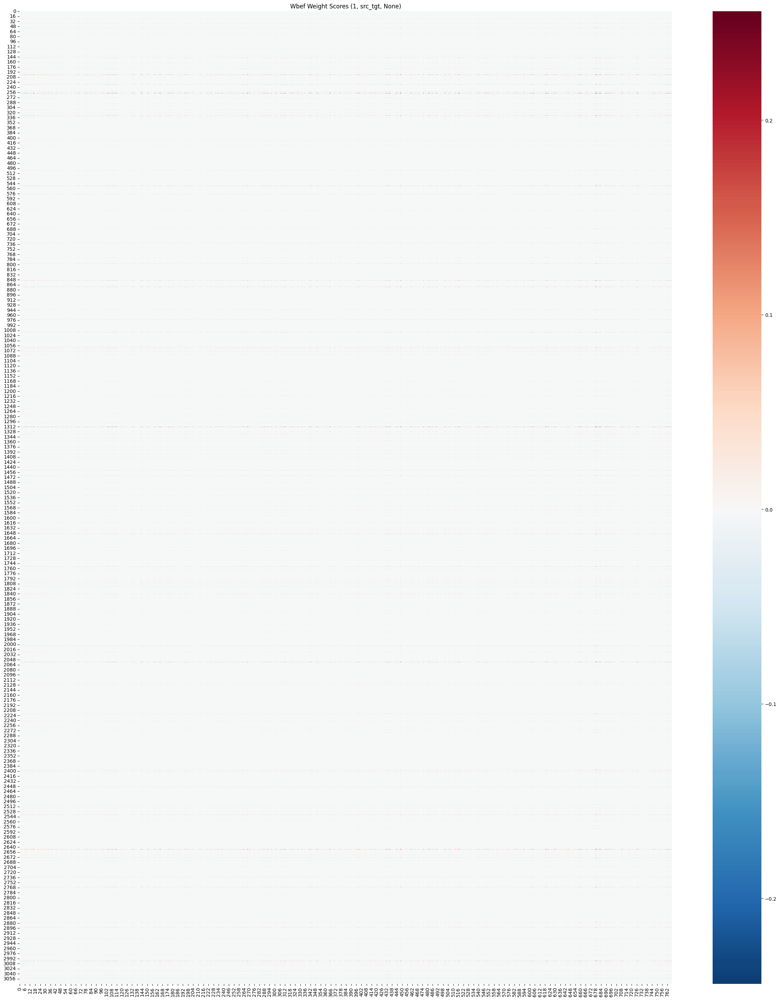

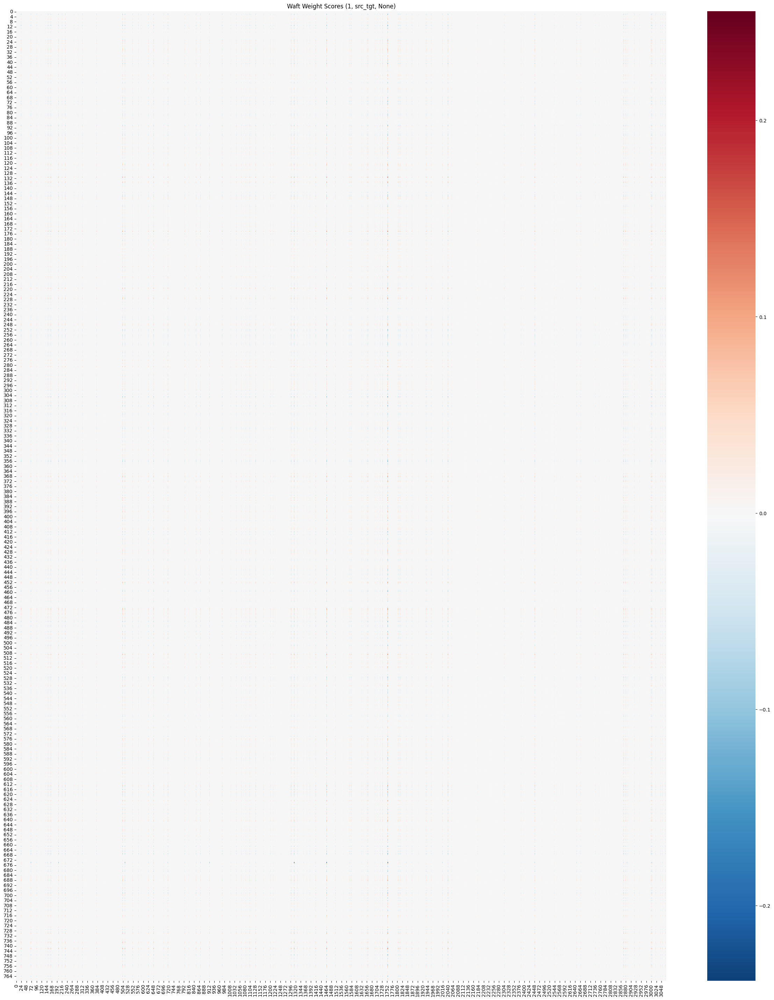

Start: ds=c100, k=0, tgt_rank=1, misclf_type=src_tgt, fpfn=fp
Start: ds=c100, k=0, tgt_rank=1, misclf_type=src_tgt, fpfn=fn
Start: ds=c100, k=0, tgt_rank=1, misclf_type=tgt, fpfn=None
(4718592,) [-9.5963478e-04 -6.4241886e-04  7.7700615e-04 ...  3.6954880e-06
  3.7550926e-06 -1.0041595e-03]
wbef_scores.shape = (3072, 768)
waft_scores.shape = (768, 3072)


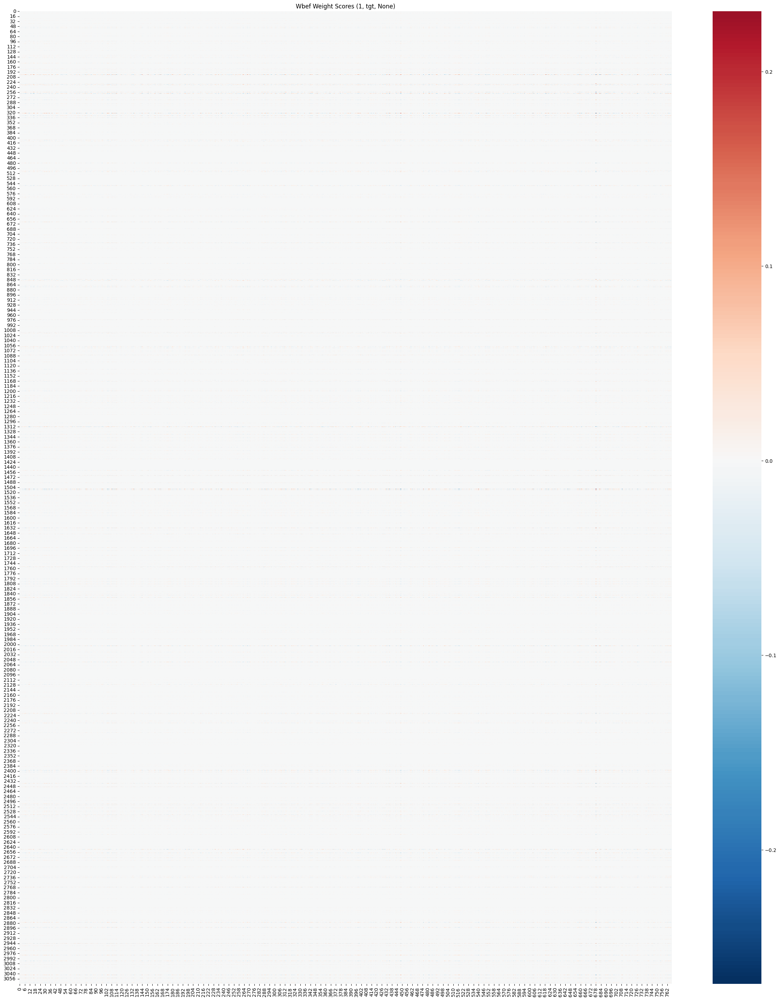

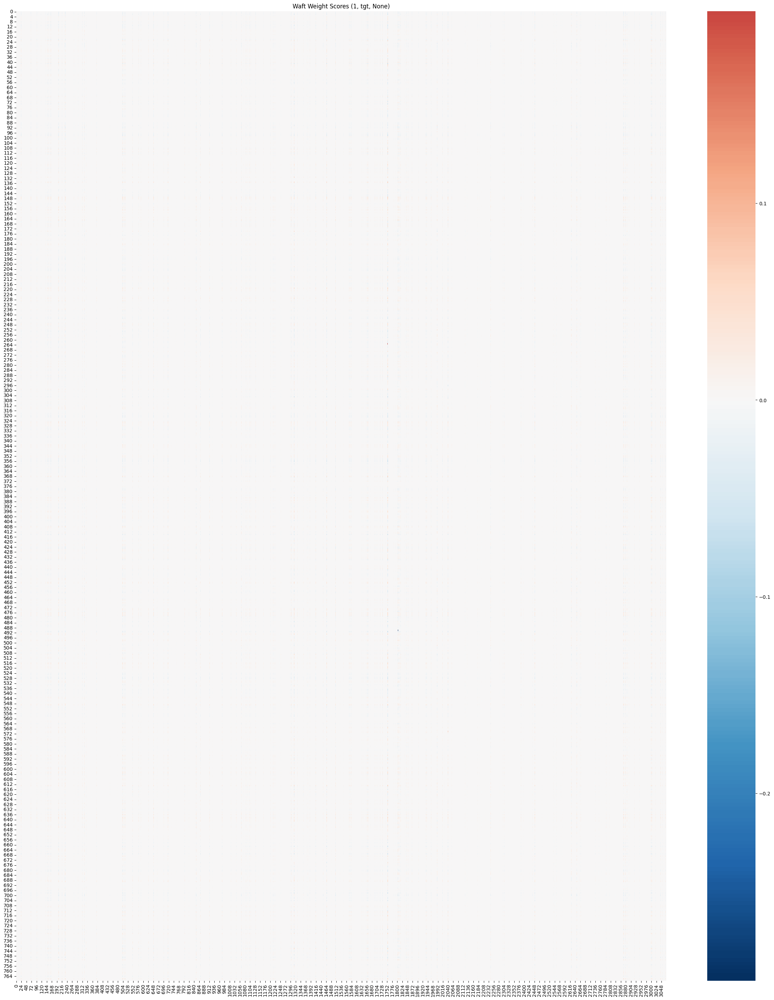

Start: ds=c100, k=0, tgt_rank=1, misclf_type=tgt, fpfn=fp
(4718592,) [-5.2300096e-04 -4.3031573e-04  5.4794550e-04 ...  2.0563602e-06
  2.0563602e-06  1.8177629e-03]
wbef_scores.shape = (3072, 768)
waft_scores.shape = (768, 3072)


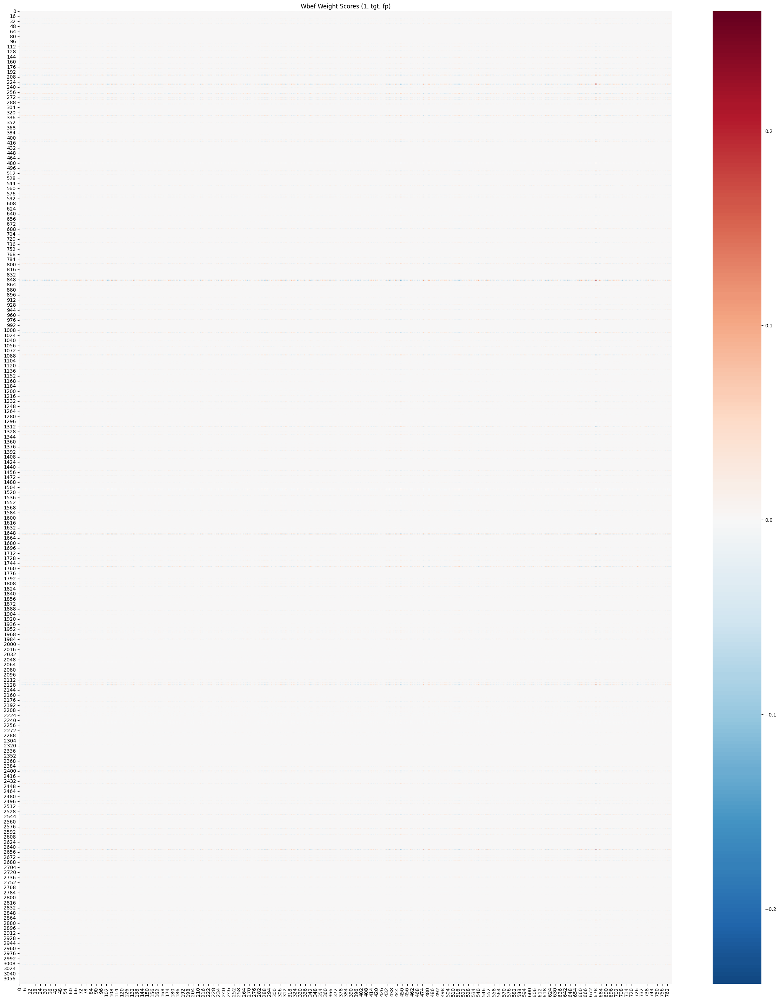

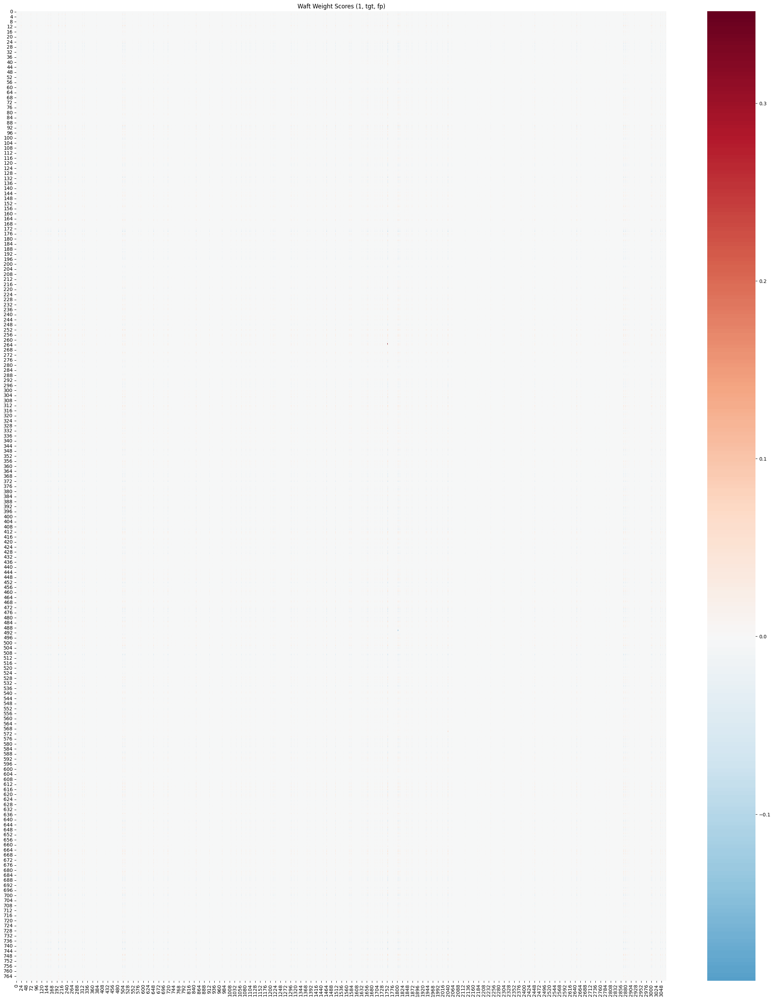

Start: ds=c100, k=0, tgt_rank=1, misclf_type=tgt, fpfn=fn
(4718592,) [-7.7486038e-05  3.4868717e-05 -7.2181225e-05 ...  1.1920929e-07
  1.7881393e-07 -2.6462078e-03]
wbef_scores.shape = (3072, 768)
waft_scores.shape = (768, 3072)


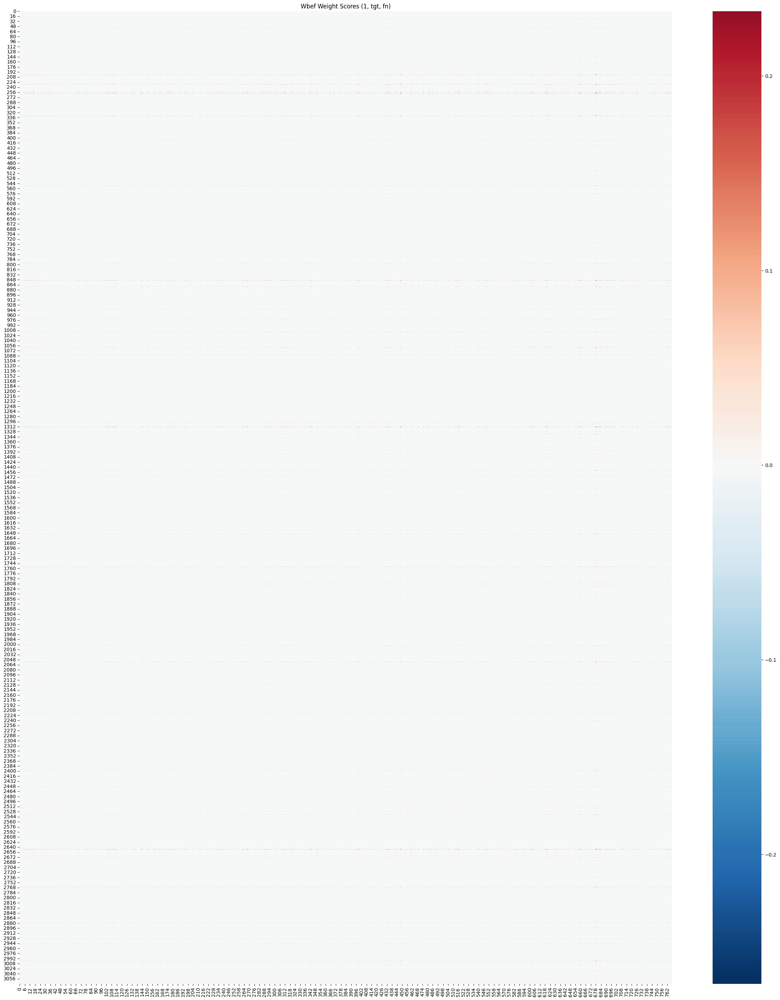

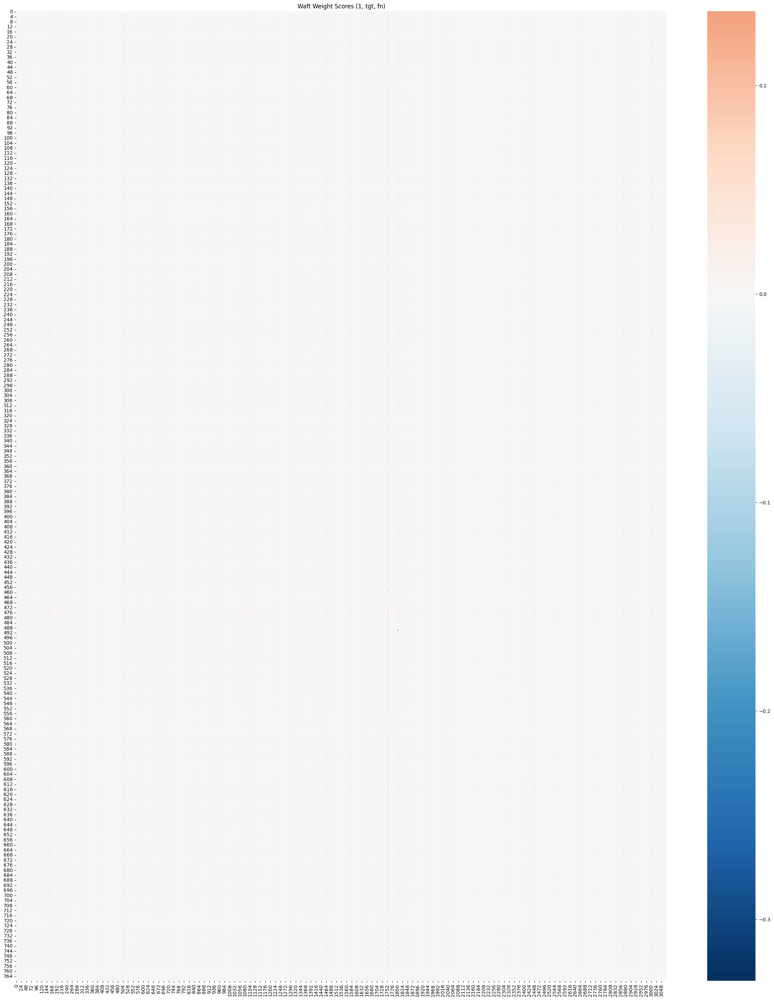

Start: ds=c100, k=0, tgt_rank=2, misclf_type=src_tgt, fpfn=None
(4718592,) [-1.37090683e-06 -1.37090683e-06 -1.37090683e-06 ... -3.81469727e-06
 -1.37090683e-06 -1.15573406e-04]
wbef_scores.shape = (3072, 768)
waft_scores.shape = (768, 3072)


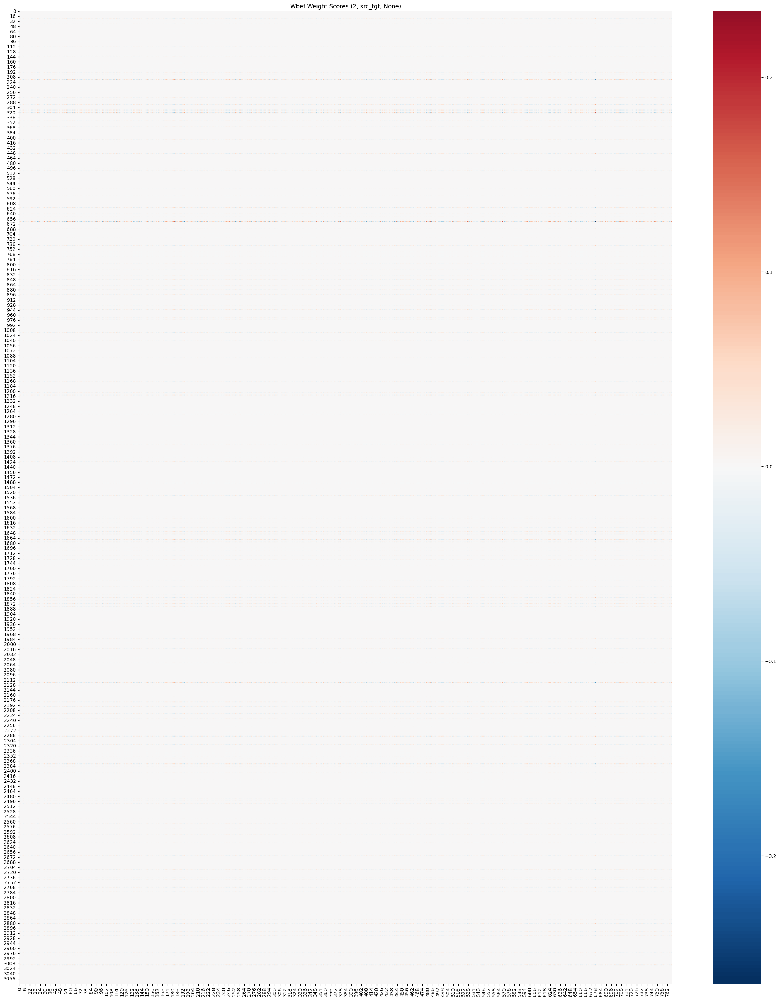

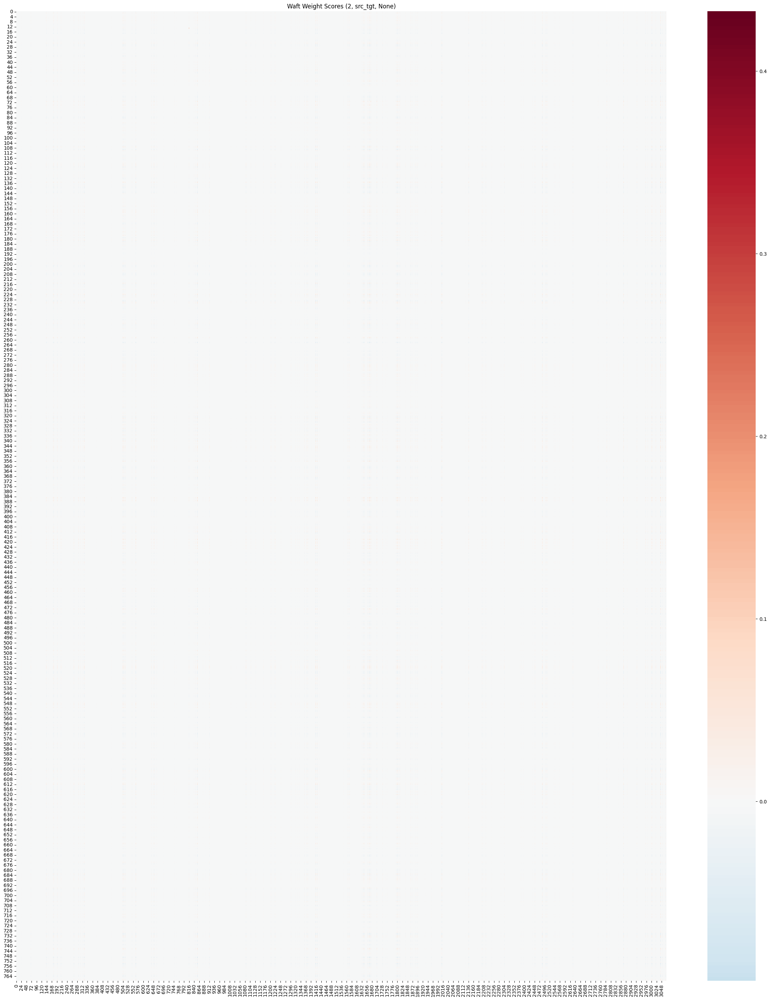

Start: ds=c100, k=0, tgt_rank=2, misclf_type=src_tgt, fpfn=fp
Start: ds=c100, k=0, tgt_rank=2, misclf_type=src_tgt, fpfn=fn
Start: ds=c100, k=0, tgt_rank=2, misclf_type=tgt, fpfn=None
(4718592,) [ 3.5762787e-06  3.5762787e-06  3.5762787e-06 ...  3.4332275e-05
  1.6689301e-06 -4.2593479e-04]
wbef_scores.shape = (3072, 768)
waft_scores.shape = (768, 3072)


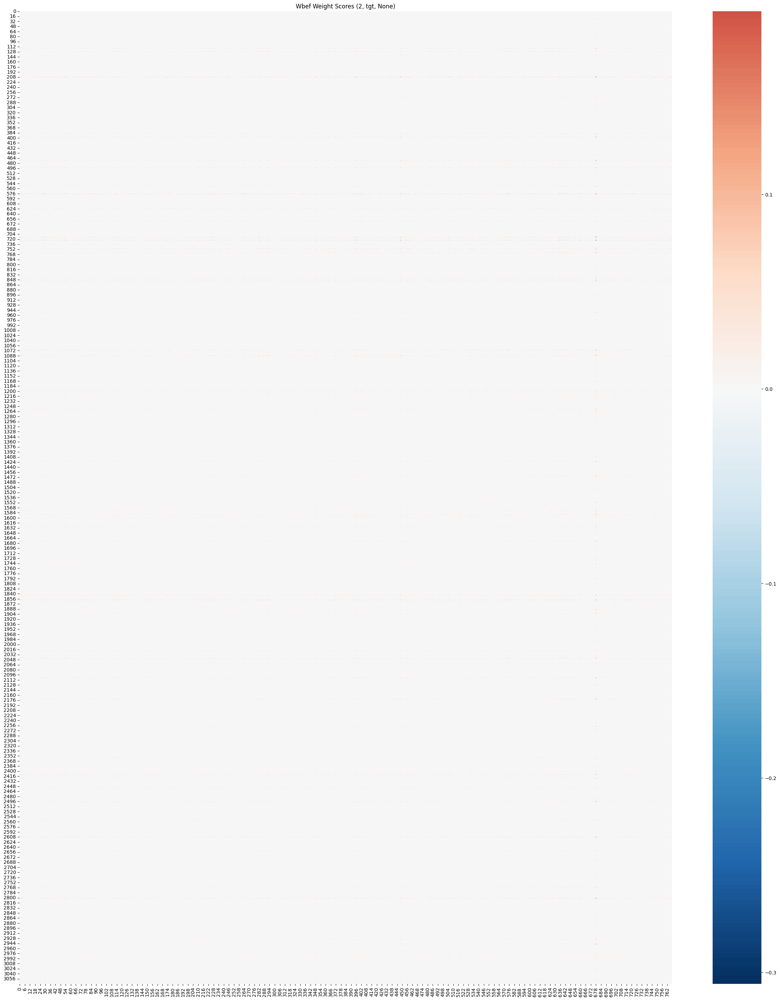

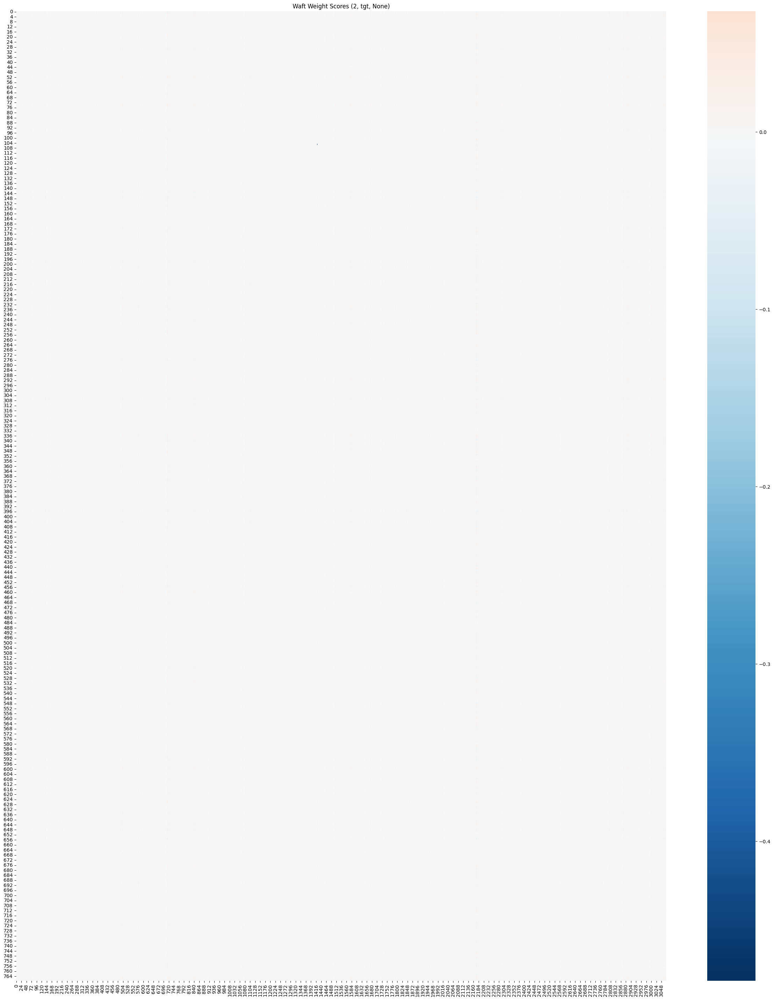

In [82]:
ds = "c100"
# k_list = range(5)
k_list = [0]
tgt_rank_list = range(1, 4)
# misclf_type_list = ["all", "src_tgt", "tgt"]
misclf_type_list = ["src_tgt", "tgt"]
fpfn_list = [None, "fp", "fn"]
exp_list = [Experiment3, ExperimentRepair1, ExperimentRepair2]

max_cnt = 5
cnt = 0

for exp in exp_list:
    n_ratio, w_num = exp.NUM_IDENTIFIED_NEURONS_RATIO, exp.NUM_IDENTIFIED_WEIGHTS
    w_num = 8 * w_num * w_num
    for k, tgt_rank, misclf_type, fpfn in product(k_list, tgt_rank_list, misclf_type_list, fpfn_list):
        print(f"Start: ds={ds}, k={k}, tgt_rank={tgt_rank}, misclf_type={misclf_type}, fpfn={fpfn}")
        if (misclf_type == "src_tgt" or misclf_type == "all") and fpfn is not None: # misclf_type == "src_tgt" or "all"の時はfpfnはNoneだけでいい
            continue
        if misclf_type == "all" and tgt_rank != 1: # misclf_type == "all"の時にtgt_rankは関係ないのでこのループもスキップすべき
            continue
        ret = weight_results[(tgt_rank, misclf_type, fpfn, n_ratio, w_num)]
        ret = ret - np.mean(ret)
        print(ret.shape, ret)
        
        # weighted_scores: shape=(4718592,)

        # 1) Wbef の要素数
        num_wbef = 3072 * 768  # 2,359,296

        # 2) Wbef 部分
        wbef_scores = ret[:num_wbef].reshape(3072, 768)

        # 3) Waft 部分
        waft_scores = ret[num_wbef:].reshape(768, 3072)

        print("wbef_scores.shape =", wbef_scores.shape)  # (3072, 768)
        print("waft_scores.shape =", waft_scores.shape)  # (768, 3072)
        
        # 例えば Wbef を可視化
        plt.figure(figsize=(30,36))
        sns.heatmap(wbef_scores, cmap="RdBu_r", center=0)
        plt.title(f"Wbef Weight Scores ({tgt_rank}, {misclf_type}, {fpfn})")
        plt.show()

        # Waft の場合
        plt.figure(figsize=(30,36))
        sns.heatmap(waft_scores, cmap="RdBu_r", center=0)
        plt.title(f"Waft Weight Scores ({tgt_rank}, {misclf_type}, {fpfn})")
        plt.show()
        
        if cnt >= max_cnt:
            break
        cnt += 1
    if cnt >= max_cnt:
        break

Wbef, Waft両方で，3072次元の方の軸が特定の値たちに対して多くの列が色付きになっている（平均的なスコアのズレ）；図的に言えば，Wbefでは横一線の色付きの線，Waftでは縦一線が複数ある．

これは特定の中間ニューロンをつなぐ重み以外は選択される機会が少ないことを意味する．

# VdiffによるSoft Gating for Arachne weight score
これをやってみて，同じように重みスコアの分布を見たい

In [86]:
# ここで想定:
#   results[(tgt_rank, misclf_type, fpfn, n_ratio, w_num)] -> np.array(shape=(3072,))
#   weight_results[(tgt_rank, misclf_type, fpfn, n_ratio, w_num)] -> np.array(shape=(4718592,))

num_wbef = 3072 * 768  # Wbef部分の要素数
beta = 0.5             # ソフトゲーティングの強度 (例)

mod_weight_results = {}

for k in tqdm(weight_results.keys()):
    if k not in results:
        # ニューロンスコアが無いキーはスキップ or そのままコピーなど
        print(f"Warning: no neuron score for key={k}")
        mod_weight_results[k] = weight_results[k].copy()
        continue
    
    neuron_scores = results[k]    # shape=(3072,)
    wscore = weight_results[k]    # shape=(4718592,)
    
    wscore_gated = wscore.copy()  # コピーして上書き（in-placeでゲーティング）

    # -------------------------------
    # 1) Wbef 部分 (行=3072, 列=768)
    # 行が中間ニューロン -> neuron_scoresの軸
    # -------------------------------
    wbef_2d = wscore_gated[:num_wbef].reshape(3072, 768)
    # neuron_scores: shape=(3072,)
    # => neuron_scores[:, np.newaxis]: shape=(3072,1)
    # => ブロードキャストで (3072,768) に対応
    wbef_2d *= (1.0 + beta * neuron_scores[:, np.newaxis])

    # -------------------------------
    # 2) Waft 部分 (行=768, 列=3072)
    # 列が中間ニューロン -> neuron_scoresの軸
    # -------------------------------
    waft_2d = wscore_gated[num_wbef:].reshape(768, 3072)
    # neuron_scores[np.newaxis,:]: shape=(1,3072)
    # => ブロードキャストで (768,3072) に対応
    waft_2d *= (1.0 + beta * neuron_scores[np.newaxis, :])

    # 結果を保存
    mod_weight_results[k] = wscore_gated

print("Done. 'mod_weight_results' に Vdiffゲーティング後の重みスコアが格納されました。")

# 以降は同様に
# wbef_gated = wscore_gated[:num_wbef].reshape(3072, 768)
# waft_gated = wscore_gated[num_wbef:].reshape(768, 3072)


  0%|          | 0/60 [00:00<?, ?it/s]

100%|██████████| 60/60 [00:00<00:00, 128.16it/s]

Done. 'mod_weight_results' に Vdiffゲーティング後の重みスコアが格納されました。


In [87]:
mod_weight_results

{(1,
  'src_tgt',
  None,
  0.03,
  73728): array([0.43244496, 0.43255436, 0.4324184 , ..., 0.43199813, 0.43210146,
        0.4375513 ], dtype=float32),
 (1,
  'tgt',
  None,
  0.03,
  73728): array([0.5496818 , 0.54999936, 0.55142033, ..., 0.5500435 , 0.5501688 ,
        0.5763859 ], dtype=float32),
 (1,
  'tgt',
  'fp',
  0.03,
  73728): array([0.4183148 , 0.41840762, 0.41938698, ..., 0.4183699 , 0.41847134,
        0.44496328], dtype=float32),
 (1,
  'tgt',
  'fn',
  0.03,
  73728): array([0.60207003, 0.60218245, 0.60207534, ..., 0.6015618 , 0.6016781 ,
        0.61671245], dtype=float32),
 (2,
  'src_tgt',
  None,
  0.03,
  73728): array([0.3526612 , 0.3526612 , 0.3526612 , ..., 0.3522489 , 0.3523318 ,
        0.35443294], dtype=float32),
 (2,
  'tgt',
  None,
  0.03,
  73728): array([0.7796962 , 0.7796962 , 0.7796962 , ..., 0.77904165, 0.7791443 ,
        0.7817469 ], dtype=float32),
 (2,
  'tgt',
  'fp',
  0.03,
  73728): array([0.5997986 , 0.5997986 , 0.5997986 , ..., 0.5990828 

Start: ds=c100, k=0, tgt_rank=1, misclf_type=src_tgt, fpfn=None
(4718592,) [-0.00109479 -0.00098538 -0.00112134 ... -0.00154161 -0.00143829
  0.00401154]
wbef_scores.shape = (3072, 768)
waft_scores.shape = (768, 3072)


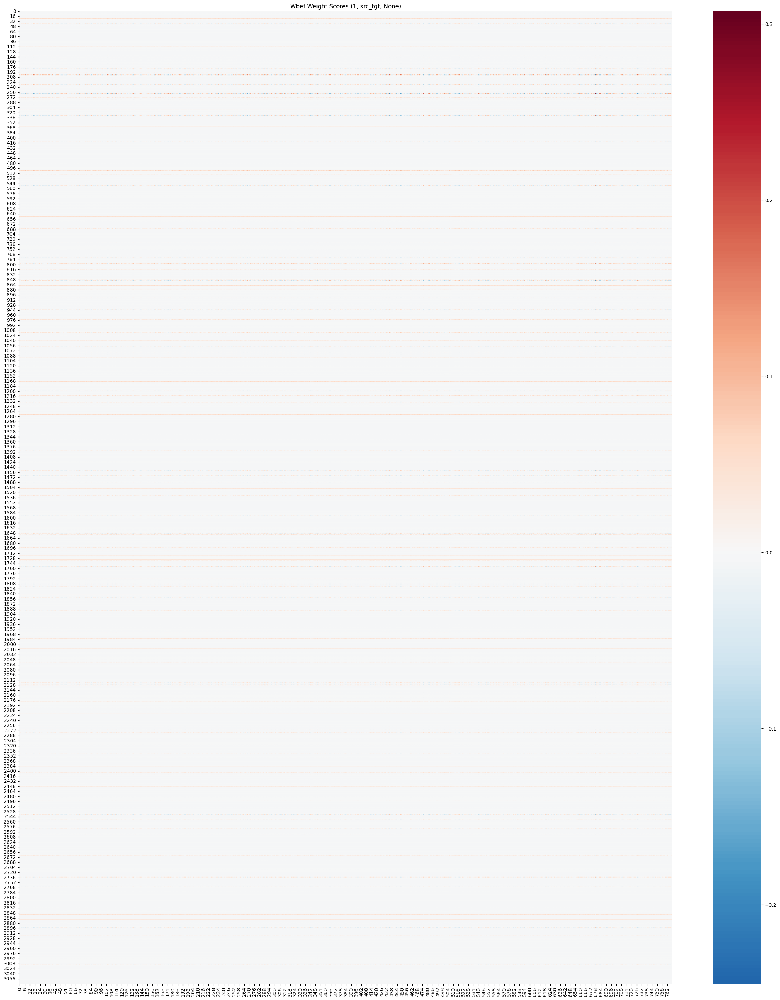

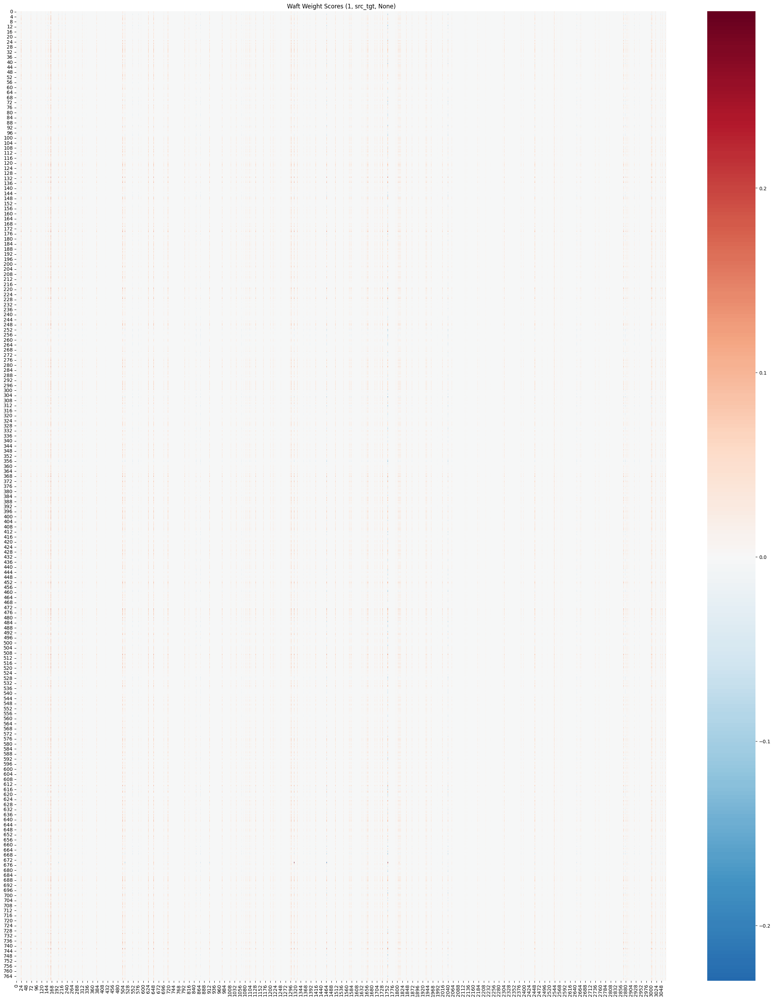

Start: ds=c100, k=0, tgt_rank=1, misclf_type=src_tgt, fpfn=fp
Start: ds=c100, k=0, tgt_rank=1, misclf_type=src_tgt, fpfn=fn
Start: ds=c100, k=0, tgt_rank=1, misclf_type=tgt, fpfn=None
(4718592,) [-0.0026893  -0.00237173 -0.00095075 ... -0.00232756 -0.00220227
  0.02401483]
wbef_scores.shape = (3072, 768)
waft_scores.shape = (768, 3072)


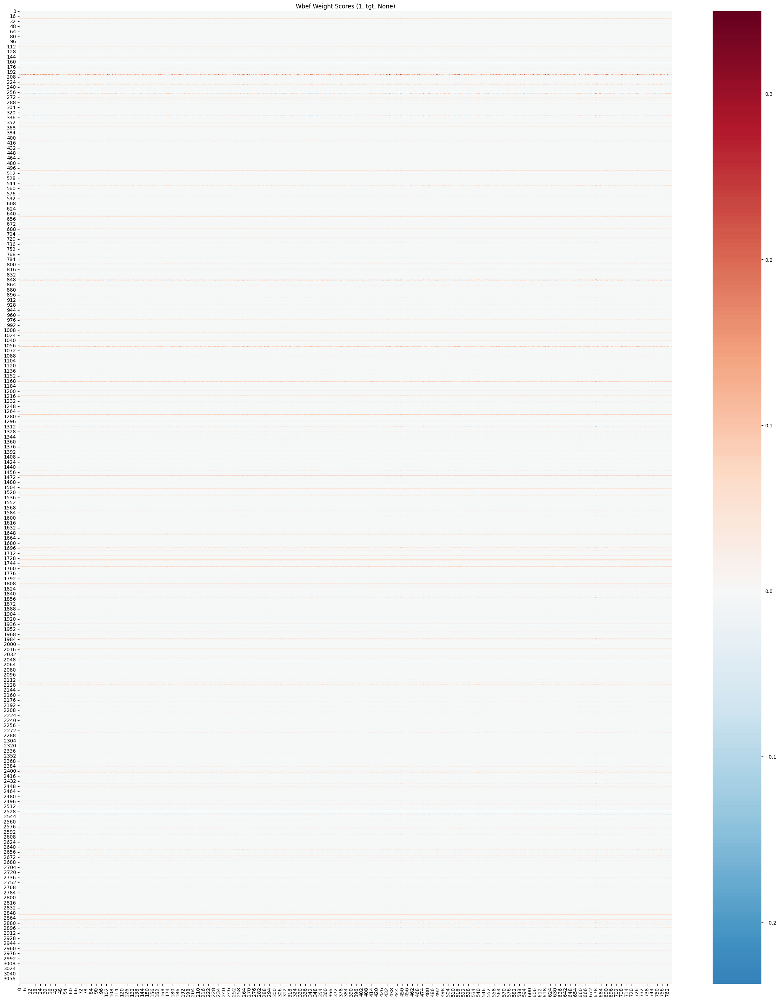

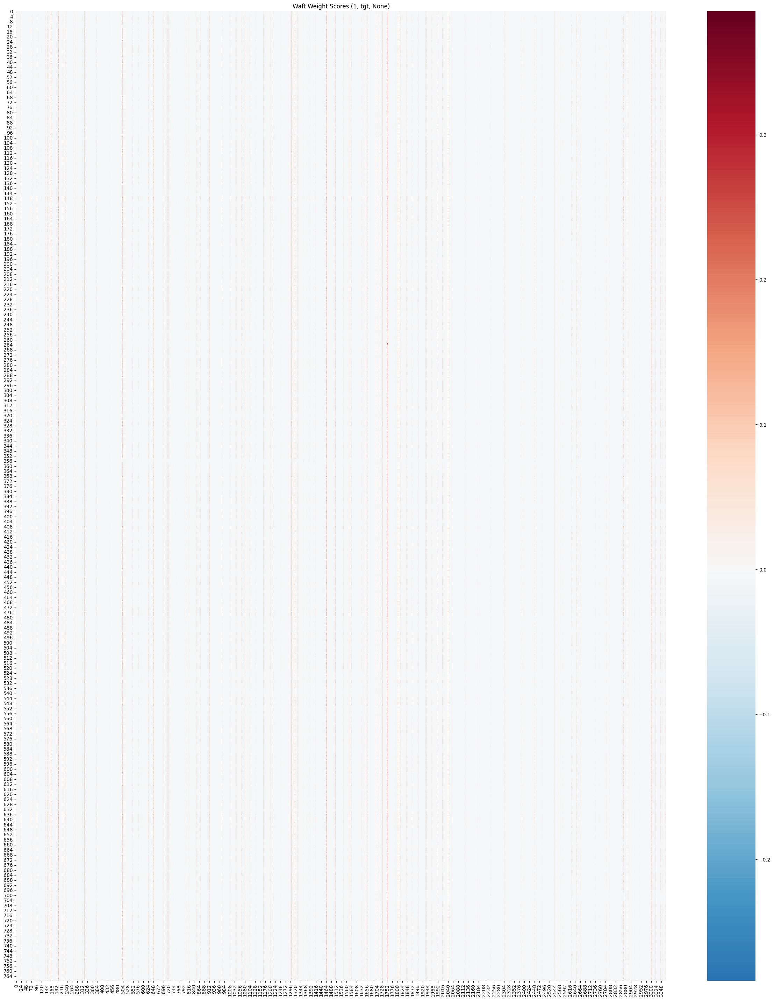

Start: ds=c100, k=0, tgt_rank=1, misclf_type=tgt, fpfn=fp
(4718592,) [-0.00172189 -0.00162908 -0.00064972 ... -0.00166681 -0.00156537
  0.02492657]
wbef_scores.shape = (3072, 768)
waft_scores.shape = (768, 3072)


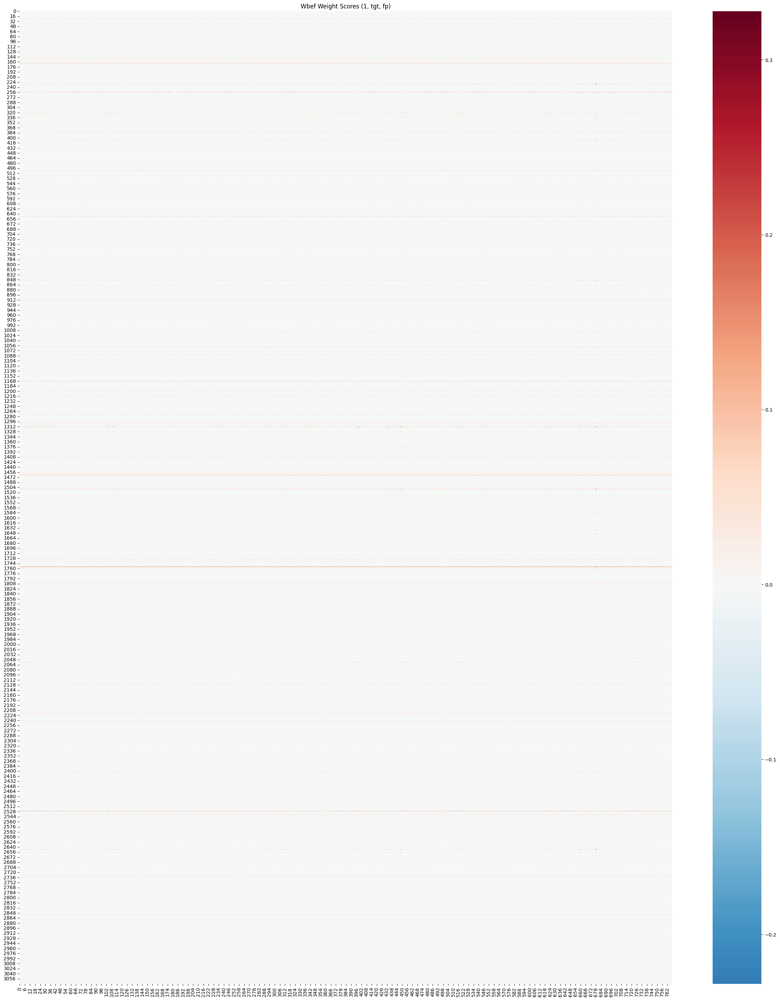

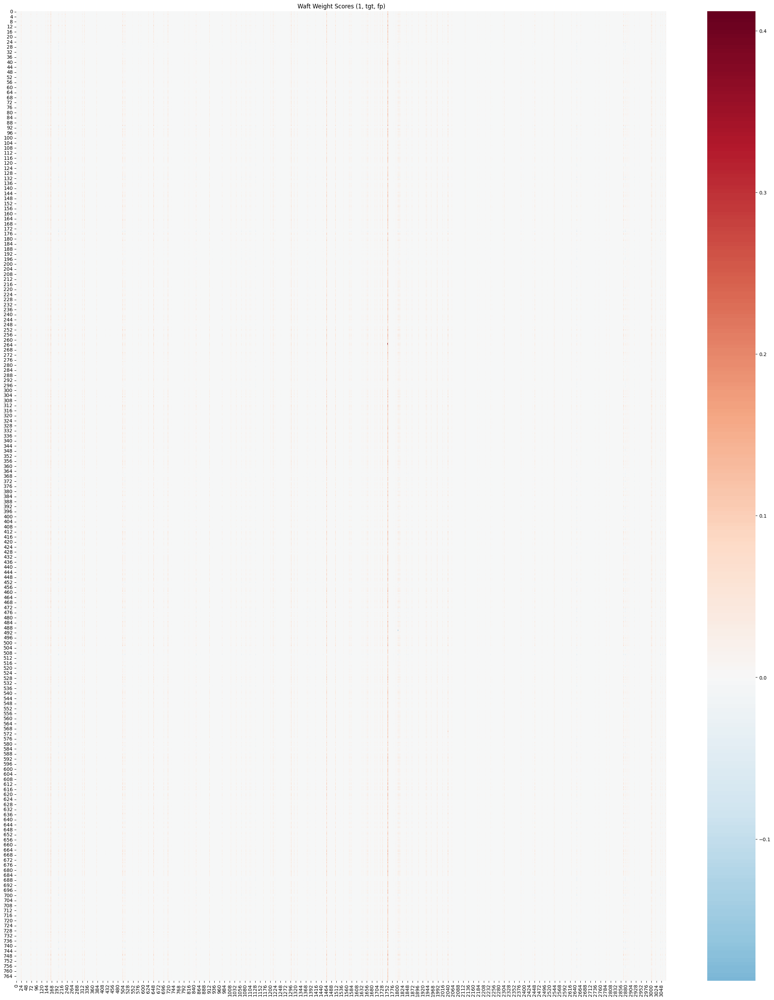

Start: ds=c100, k=0, tgt_rank=1, misclf_type=tgt, fpfn=fn
(4718592,) [-0.00148052 -0.00136811 -0.00147521 ... -0.00198877 -0.00187248
  0.0131619 ]
wbef_scores.shape = (3072, 768)
waft_scores.shape = (768, 3072)


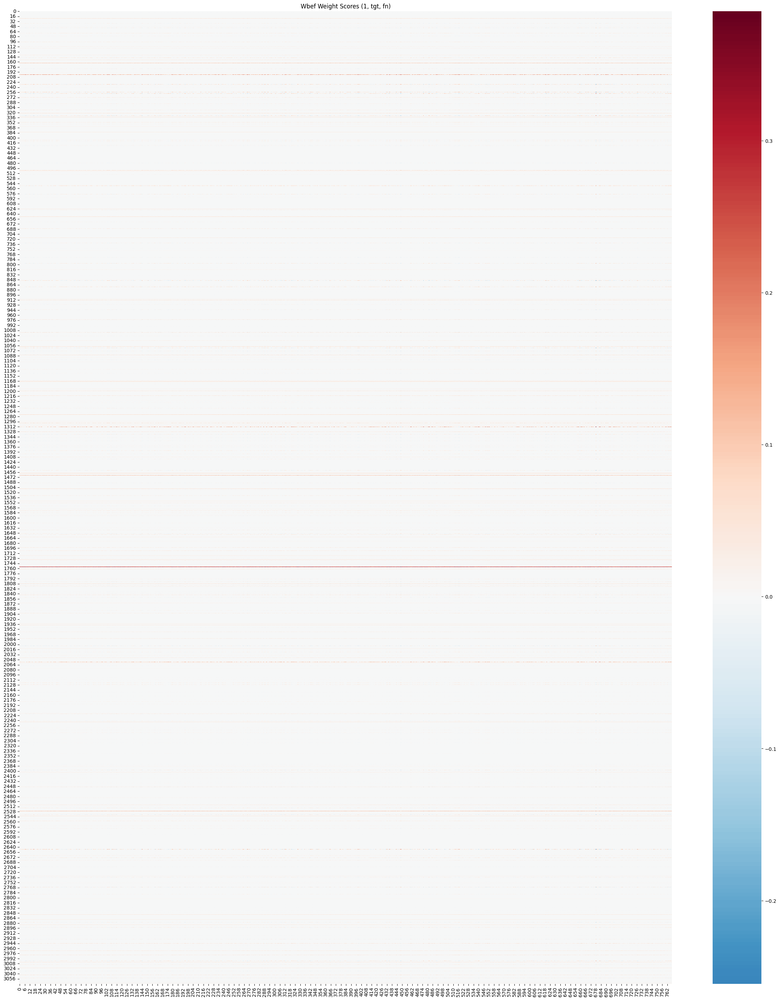

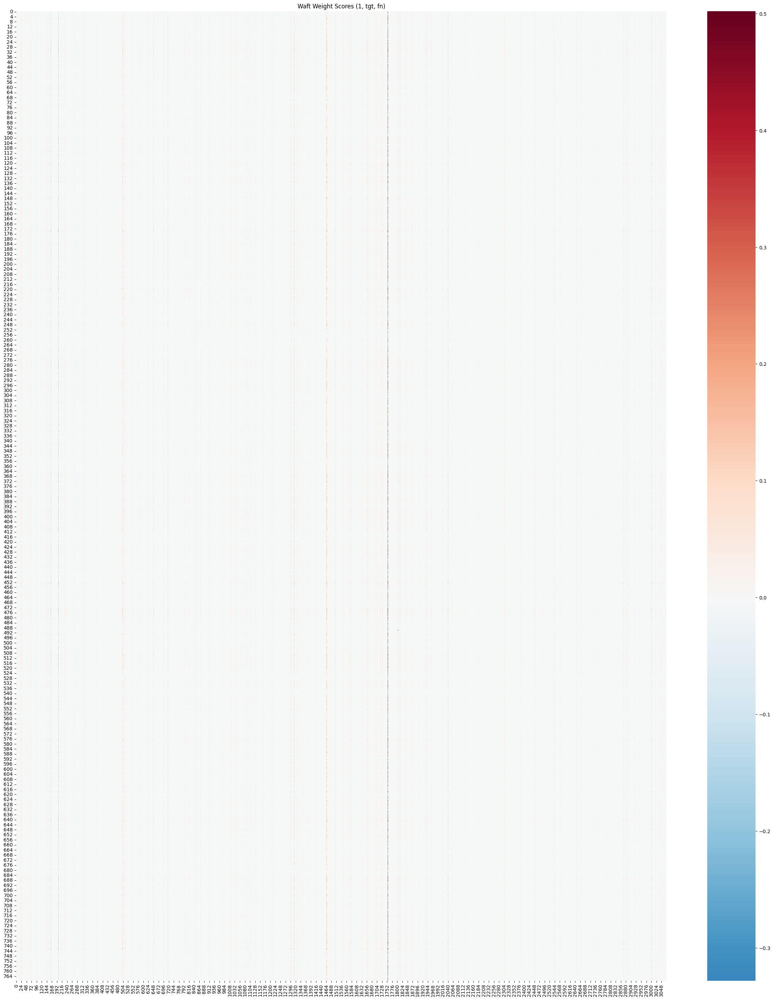

Start: ds=c100, k=0, tgt_rank=2, misclf_type=src_tgt, fpfn=None
(4718592,) [-0.00095493 -0.00095493 -0.00095493 ... -0.00136721 -0.00128433
  0.00081682]
wbef_scores.shape = (3072, 768)
waft_scores.shape = (768, 3072)


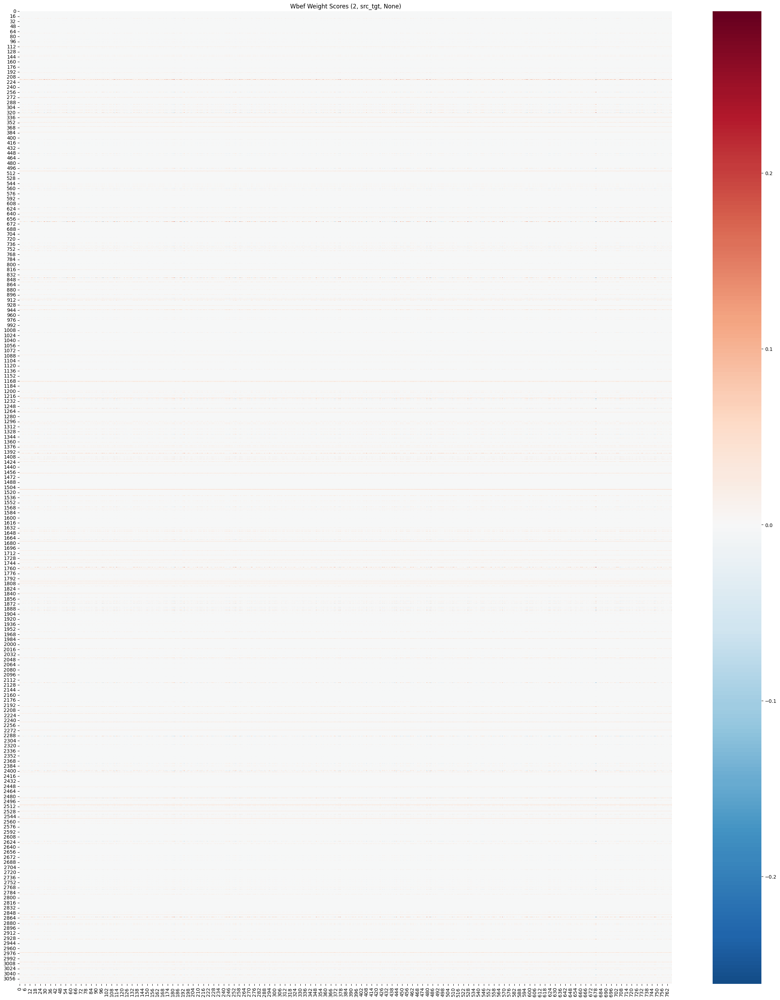

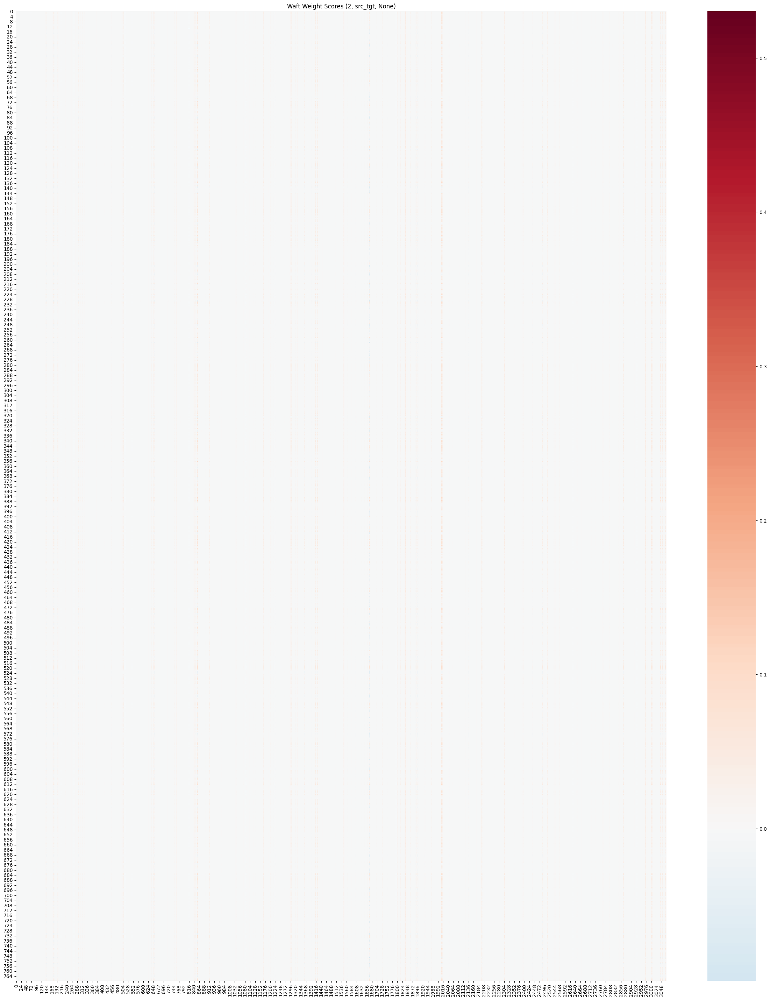

Start: ds=c100, k=0, tgt_rank=2, misclf_type=src_tgt, fpfn=fp
Start: ds=c100, k=0, tgt_rank=2, misclf_type=src_tgt, fpfn=fn
Start: ds=c100, k=0, tgt_rank=2, misclf_type=tgt, fpfn=None
(4718592,) [-2.1025538e-03 -2.1025538e-03 -2.1025538e-03 ... -2.7571321e-03
 -2.6544929e-03 -5.1856041e-05]
wbef_scores.shape = (3072, 768)
waft_scores.shape = (768, 3072)


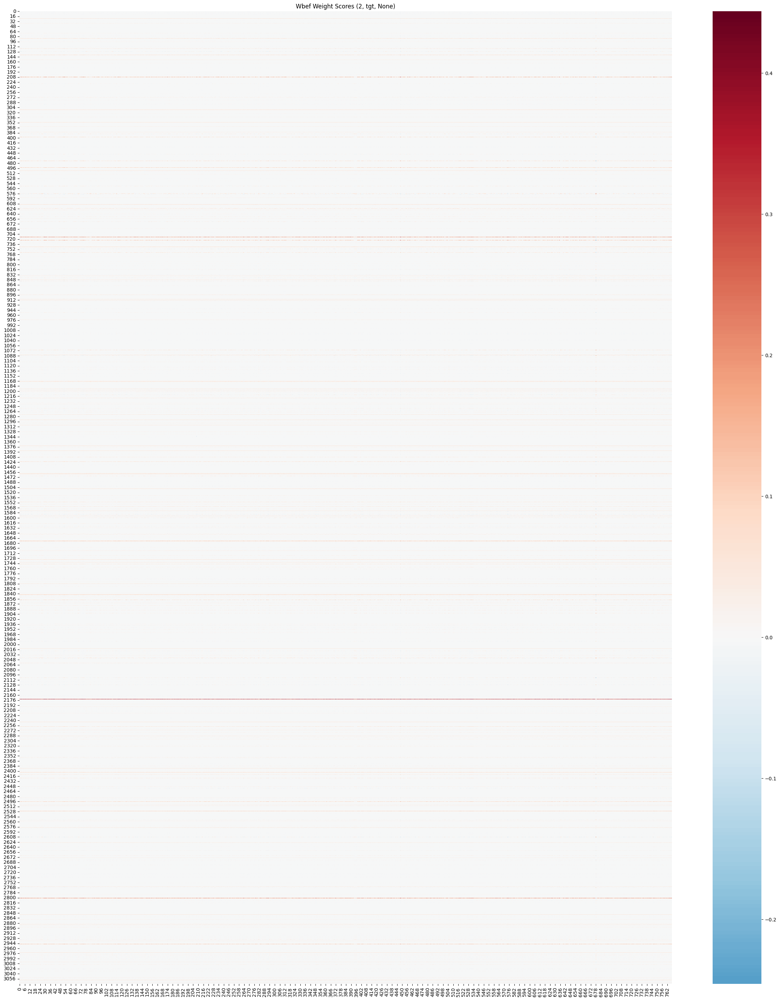

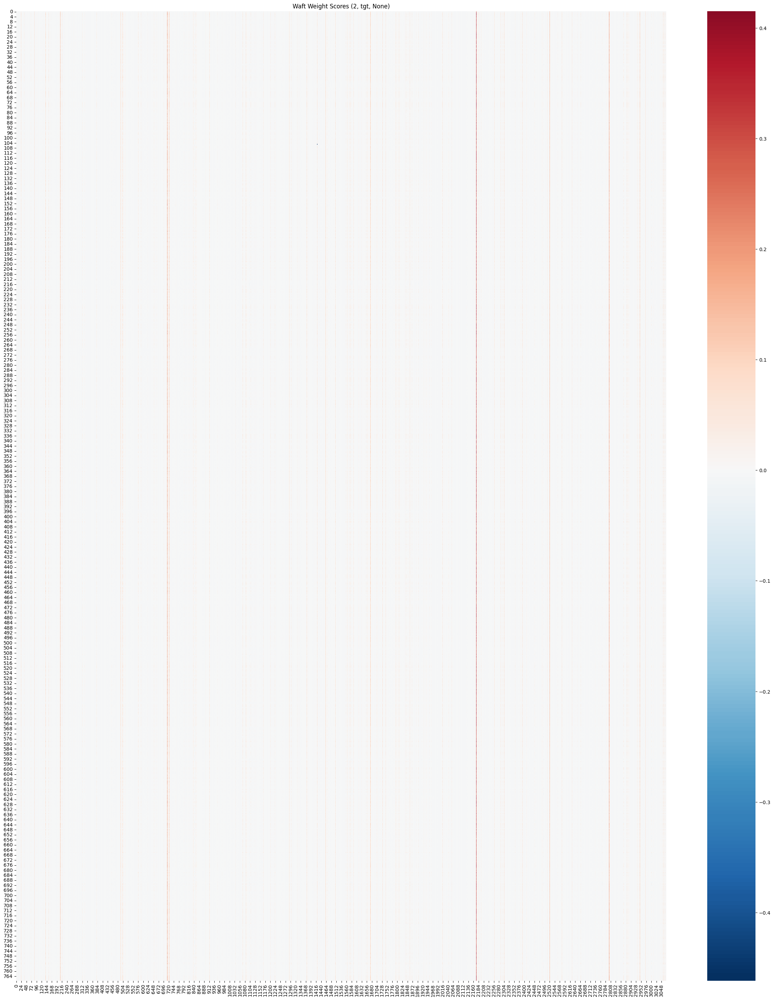

: 

In [ ]:
ds = "c100"
# k_list = range(5)
k_list = [0]
tgt_rank_list = range(1, 4)
# misclf_type_list = ["all", "src_tgt", "tgt"]
misclf_type_list = ["src_tgt", "tgt"]
fpfn_list = [None, "fp", "fn"]
exp_list = [Experiment3, ExperimentRepair1, ExperimentRepair2]

max_cnt = 5
cnt = 0

for exp in exp_list:
    n_ratio, w_num = exp.NUM_IDENTIFIED_NEURONS_RATIO, exp.NUM_IDENTIFIED_WEIGHTS
    w_num = 8 * w_num * w_num
    for k, tgt_rank, misclf_type, fpfn in product(k_list, tgt_rank_list, misclf_type_list, fpfn_list):
        print(f"Start: ds={ds}, k={k}, tgt_rank={tgt_rank}, misclf_type={misclf_type}, fpfn={fpfn}")
        if (misclf_type == "src_tgt" or misclf_type == "all") and fpfn is not None: # misclf_type == "src_tgt" or "all"の時はfpfnはNoneだけでいい
            continue
        if misclf_type == "all" and tgt_rank != 1: # misclf_type == "all"の時にtgt_rankは関係ないのでこのループもスキップすべき
            continue
        ret = mod_weight_results[(tgt_rank, misclf_type, fpfn, n_ratio, w_num)]
        ret = ret - np.mean(ret)
        print(ret.shape, ret)
        
        # weighted_scores: shape=(4718592,)

        # 1) Wbef の要素数
        num_wbef = 3072 * 768  # 2,359,296

        # 2) Wbef 部分
        wbef_scores = ret[:num_wbef].reshape(3072, 768)

        # 3) Waft 部分
        waft_scores = ret[num_wbef:].reshape(768, 3072)

        print("wbef_scores.shape =", wbef_scores.shape)  # (3072, 768)
        print("waft_scores.shape =", waft_scores.shape)  # (768, 3072)
        
        # 例えば Wbef を可視化
        plt.figure(figsize=(30,36))
        sns.heatmap(wbef_scores, cmap="RdBu_r", center=0)
        plt.title(f"Wbef Weight Scores ({tgt_rank}, {misclf_type}, {fpfn})")
        plt.show()

        # Waft の場合
        plt.figure(figsize=(30,36))
        sns.heatmap(waft_scores, cmap="RdBu_r", center=0)
        plt.title(f"Waft Weight Scores ({tgt_rank}, {misclf_type}, {fpfn})")
        plt.show()
        
        if cnt >= max_cnt:
            break
        cnt += 1
    if cnt >= max_cnt:
        break